
---
# <center>YouTube Trending Video Data Analysis</center>
---

### Project Goals & KPIs:
- Engagement Rate
- Avg. Time to Trend
- Top Categories by Views
- Top Performing Channels
- Top countries Activity / views
- What’s the best hour/day to post videos?
- correlation between **publish_time** and **engagement**
- Do videos with disabled comments perform worse?

### Project Overview
This project analyzes **YouTube trending video data across multiple countries** to uncover insights into viewer engagement, **optimal posting times**, **top-performing channels**, and more. The analysis leverages **Python (Pandas, Plotly, Seaborn)** and focuses on understanding what drives video performance on YouTube.

In [1]:
# libraries i will use
import pandas as pd
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.io as pio

### Merge All **.csv** Files and Add **country** Column

In [2]:
# Modules for use in merging files
import glob
import os

In [3]:
# define data path
data_path = "C:/Users/LOQ/data_analysis/My_projects/YT_Ptoject/Data/data"

In [4]:
# Get list of video CSV files only
video_files = glob.glob(os.path.join(data_path, '*videos.csv'))
# check
video_files

['C:/Users/LOQ/data_analysis/My_projects/YT_Ptoject/Data/data\\CAvideos.csv',
 'C:/Users/LOQ/data_analysis/My_projects/YT_Ptoject/Data/data\\DEvideos.csv',
 'C:/Users/LOQ/data_analysis/My_projects/YT_Ptoject/Data/data\\FRvideos.csv',
 'C:/Users/LOQ/data_analysis/My_projects/YT_Ptoject/Data/data\\GBvideos.csv',
 'C:/Users/LOQ/data_analysis/My_projects/YT_Ptoject/Data/data\\INvideos.csv',
 'C:/Users/LOQ/data_analysis/My_projects/YT_Ptoject/Data/data\\JPvideos.csv',
 'C:/Users/LOQ/data_analysis/My_projects/YT_Ptoject/Data/data\\KRvideos.csv',
 'C:/Users/LOQ/data_analysis/My_projects/YT_Ptoject/Data/data\\MXvideos.csv',
 'C:/Users/LOQ/data_analysis/My_projects/YT_Ptoject/Data/data\\RUvideos.csv',
 'C:/Users/LOQ/data_analysis/My_projects/YT_Ptoject/Data/data\\USvideos.csv']

In [5]:
# Merge all files into one DataFrame
dfs = []
for file in video_files:
    country = os.path.basename(file)[:2]
    df = pd.read_csv(file, encoding='latin1')
    df['country'] = country
    dfs.append(df)
df_all = pd.concat(dfs, ignore_index=True)

In [6]:
# check
df_all.sample(5)

,video_id,trending_date,title,channel_title,category_id,publish_time,tags,views,likes,dislikes,comment_count,thumbnail_link,comments_disabled,ratings_disabled,video_error_or_removed,description,country
125427,4zD4HPlc-BE,17.28.11,Ricky Rebel - Time,Ricky Rebel,26,2017-10-30T13:13:28.000Z,"Ricky Rebel|""GLambert""|""pop""|""star""|""idol""|""bo...",78106,157,3,16,https://i.ytimg.com/vi/4zD4HPlc-BE/default.jpg,False,False,False,Ricky Rebel - Time\nWritten and Produced by: R...,GB
19520,8s5b77qRrE0,18.21.02,BIGGEST BASKETBALL MATCH OF MY LIFE!!!,Jesser,20,2018-02-20T00:15:48.000Z,"jesser|""NBA""|""Basketball""|""2K""|""james harden""|...",573726,28965,288,2092,https://i.ytimg.com/vi/8s5b77qRrE0/default.jpg,False,False,False,The James Harden Invitational tournament! \nâ...,CA
278958,to5rlOPnNMg,18.22.03,spOnsOr: Por Vaga,enchufetv,23,2018-03-21T21:31:41.000Z,"enchufetv|""enchufe""|""tv""|""2018""|""Nataly Valenc...",642202,40545,930,1421,https://i.ytimg.com/vi/to5rlOPnNMg/default.jpg,False,False,False,Me confirman ð¯ Â¿En PerÃº tirarse la pera s...,MX
277702,TRHtgMYPioI,18.15.03,UÃAS DECORADAS PASO A PASO MARZO 2018,MoDa ViraL,22,2018-03-14T23:07:51.000Z,"UÃAS DECORADAS PASO A PASO MARZO 2018|""UÃAS ...",11106,605,13,30,https://i.ytimg.com/vi/TRHtgMYPioI/default.jpg,False,False,False,WARNING!!!\nCredit & Full Video:\nInstagram: ...,MX
198111,IehQZ_K5oEM,18.11.06,Phulpakhru - à¤«à¥à¤²à¤ªà¤¾à¤à¤°à¥ - Episod...,Zee Yuva,22,2018-06-10T06:42:50.000Z,"Phulpakhru|""Phulpakhru Best Scene""|""phulpakhar...",23966,135,8,6,https://i.ytimg.com/vi/IehQZ_K5oEM/default.jpg,False,False,False,"To watch FULL episode of Phulpakhru, CLICK her...",IN


#### Map ***category_id*** to Category Name using .json Files

In [7]:
# Function to load a single JSON file and return {id:name} dictionary
def load_category_mapping(json_path):
    with open(json_path, 'r') as f:
        data = json.load(f)
    return {
        int(item['id']): item['snippet']['title']
        for item in data['items']
    }

In [8]:
# Load one JSON
us_categories = load_category_mapping(r"C:\Users\LOQ\data_analysis\My_projects\YT_Ptoject\Data\data\US_category_id.json")

In [9]:
#check
us_categories[33]

'Classics'

In [10]:
# Map to the full DataFrame
df_all['category_name'] = df_all['category_id'].map(us_categories)

In [11]:
#check
df_all[['title', 'category_id', 'category_name', 'country']].head(2)

,title,category_id,category_name,country
0,Eminem - Walk On Water (Audio) ft. BeyoncÃ©,10,Music,CA
1,PLUSH - Bad Unboxing Fan Mail,23,Comedy,CA


## Initial Exploration
___

In [12]:
df_copy = df_all.copy()

In [13]:
df_all.sample(2)

,video_id,trending_date,title,channel_title,category_id,publish_time,tags,views,likes,dislikes,comment_count,thumbnail_link,comments_disabled,ratings_disabled,video_error_or_removed,description,country,category_name
297659,qFsGYP8eZDQ,17.01.12,ÐÑÐµÐ»Ñ Ð­Ð»ÐµÐ¾Ð½ - Ð¡ÐµÑÐ¸Ñ 9 ÑÐµÐ·Ð¾Ð...,serial,24,2017-11-30T16:55:41.000Z,"ÑÐ¼Ð¾ÑÑÐµÑÑ Ð¾Ð½Ð»Ð°Ð¹Ð½|""ÑÐ¼Ð¾ÑÑÐµÑÑ...",677952,9362,405,964,https://i.ytimg.com/vi/qFsGYP8eZDQ/default.jpg,False,False,False,ÐÑÐµÐ»Ñ Ð­Ð»ÐµÐ¾Ð½ - Ð¡ÐµÑÐ¸Ñ 9 ÑÐµÐ·Ð¾Ð...,RU,Entertainment
177994,krolsw9KVFs,18.13.02,TYPES OF PEOPLE DURING VALENTINE'S WEEK | Hasl...,Hasley India,23,2018-02-09T13:13:47.000Z,"hasley|""india""|""harsh""|""beniwal""|""rishhsome""|""...",888559,30887,1906,1147,https://i.ytimg.com/vi/krolsw9KVFs/default.jpg,False,False,False,From rose day to kiss day there are different ...,IN,Comedy


In [14]:
df_all.shape

(375942, 18)

In [15]:
df_all.describe()

,category_id,views,likes,dislikes,comment_count
count,375942.000000,3.759420e+05,3.759420e+05,3.759420e+05,3.759420e+05
mean,20.232302,1.326568e+06,3.788431e+04,2.126107e+03,4.253775e+03
std,7.132413,7.098568e+06,1.654131e+05,2.248437e+04,2.545876e+04
min,1.000000,1.170000e+02,0.000000e+00,0.000000e+00,0.000000e+00
25%,17.000000,4.697800e+04,6.690000e+02,4.100000e+01,1.090000e+02
50%,23.000000,1.773705e+05,3.446000e+03,1.790000e+02,5.110000e+02
75%,24.000000,6.476792e+05,1.747650e+04,7.490000e+02,2.011000e+03
max,44.000000,4.245389e+08,5.613827e+06,1.944971e+06,1.626501e+06


In [16]:
df_all.dtypes

video_id                  object
trending_date             object
title                     object
channel_title             object
category_id                int64
publish_time              object
tags                      object
views                      int64
likes                      int64
dislikes                   int64
comment_count              int64
thumbnail_link            object
comments_disabled           bool
ratings_disabled            bool
video_error_or_removed      bool
description               object
country                   object
category_name             object
dtype: object

In [17]:
df.isnull().sum()

video_id                    0
trending_date               0
title                       0
channel_title               0
category_id                 0
publish_time                0
tags                        0
views                       0
likes                       0
dislikes                    0
comment_count               0
thumbnail_link              0
comments_disabled           0
ratings_disabled            0
video_error_or_removed      0
description               570
country                     0
dtype: int64

In [18]:
df_all.duplicated().sum()

12570

## During initial data exploration, we identified:
- 12,570 duplicate rows, which were removed.
- 570 missing values, which were cleaned.
- Incorrect data types for `trending_date` and `publish_time`.
- Unnecessary columns removed: `video_id`, `category_id`, etc.
---

## Data cleaning & Preparation
---

In [19]:
# Handling missing values
df_all.fillna('No_description',inplace=True)
#check
df_all['description'].isnull().sum()

0

In [20]:
# Drop duplicated rows
df_all.drop_duplicates(inplace=True)
# check
df_all.duplicated().sum()

0

In [21]:
# Drop unnecessary columns
df_all.drop(columns= ['video_id','category_id','tags','thumbnail_link'],inplace=True)
# check
df_all.columns

Index(['trending_date', 'title', 'channel_title', 'publish_time', 'views',
       'likes', 'dislikes', 'comment_count', 'comments_disabled',
       'ratings_disabled', 'video_error_or_removed', 'description', 'country',
       'category_name'],
      dtype='object')

In [22]:
# rename columns
df_all.rename(columns={'comment_count':'comments','category_name':'category'},inplace= True)
# check
df_all.columns

Index(['trending_date', 'title', 'channel_title', 'publish_time', 'views',
       'likes', 'dislikes', 'comments', 'comments_disabled',
       'ratings_disabled', 'video_error_or_removed', 'description', 'country',
       'category'],
      dtype='object')

In [23]:
# converting 'trending_date' column to date
df_all['trending_date']= pd.to_datetime(df_all['trending_date'],format= '%y.%d.%m')
# edite format
df_all['trending_date']=df_all['trending_date'].dt.strftime('%m/%d/%Y')

In [24]:
# return 'trending_date' column to date 
df_all['trending_date']= pd.to_datetime(df_all['trending_date'],format='%m/%d/%Y')

In [25]:
# check 
df_all.dtypes

trending_date             datetime64[ns]
title                             object
channel_title                     object
publish_time                      object
views                              int64
likes                              int64
dislikes                           int64
comments                           int64
comments_disabled                   bool
ratings_disabled                    bool
video_error_or_removed              bool
description                       object
country                           object
category                          object
dtype: object

In [26]:
# converting 'publish_time' column to date
df_all['publish_time'] = pd.to_datetime(df_all['publish_time'])
# check
df_all['publish_time'].sample(5)

176480   2018-01-31 12:43:30+00:00
247802   2018-05-09 05:01:15+00:00
30241    2018-04-21 14:16:17+00:00
117836   2018-05-21 08:51:03+00:00
362842   2018-03-27 22:00:02+00:00
Name: publish_time, dtype: datetime64[ns, UTC]

---
#### columns I will need in my analysis:
- ['engagement_rate','publish_day','publish_time']

In [27]:
# creating engagement_rate column
df_all['engagement_rate']= (df_all['likes']+ df_all['comments']) / df_all['views']

In [28]:
# creating publish_day column
df_all['publish_day'] = df_all['publish_time'].dt.date

In [29]:
# creating publish_time column
df_all['publish_time'] = df_all['publish_time'].dt.time

In [30]:
df_all.sample(5)

,trending_date,title,channel_title,publish_time,views,likes,dislikes,comments,comments_disabled,ratings_disabled,video_error_or_removed,description,country,category,engagement_rate,publish_day
61659,2018-02-28,Auf der Berlinale kennt uns NIEMAND :(,PietSmiet,13:05:00,119546,7526,162,289,False,False,False,Brammen war auf der Berlinale beim Medienboard...,DE,Entertainment,0.065372,2018-02-27
253072,2018-06-10,SHINee ì¤ì´ë 'I Want You' Teaser #2,SMTOWN,15:00:03,397592,62772,149,2522,False,False,False,SHINee's the 6th album 'The Story of Lightâ ...,KR,Music,0.164224,2018-06-08
12402,2018-01-17,Kodak Black - Roll In Peace feat. XXXTentacion...,Kodak Black,19:04:29,2918806,165230,4459,17699,False,False,False,Kodak Black - Roll In Peace feat. XXXTENTACION...,CA,Music,0.062673,2018-01-15
202965,2018-03-03,ëí¼ìì°ë¤ ì íë¬´â¥ííì§ ííë...,êµ¬ë íê¸°ê¾¹ê¾¹ì°ë¥´í¤,21:54:58,326915,1985,97,307,False,False,False,No_description,JP,People & Blogs,0.007011,2018-03-02
374196,2018-06-06,MNEK - Colour (Lyric Video) ft. Hailee Steinfeld,MNEKVEVO,13:48:48,350884,21185,348,885,False,False,False,MNEK â Colour (ft Hailee Steinfeld) is avail...,US,Music,0.062898,2018-06-01


In [31]:
df_all.dtypes

trending_date             datetime64[ns]
title                             object
channel_title                     object
publish_time                      object
views                              int64
likes                              int64
dislikes                           int64
comments                           int64
comments_disabled                   bool
ratings_disabled                    bool
video_error_or_removed              bool
description                       object
country                           object
category                          object
engagement_rate                  float64
publish_day                       object
dtype: object

In [32]:
# Convert publish_time column to datetime.time 
df_all['publish_time'] = pd.to_datetime(df_all['publish_time'], format='%H:%M:%S').dt.time

In [33]:
# Convert publish_day column to datetime 
df_all['publish_day'] = pd.to_datetime(df_all['publish_day'], format='%Y-%m-%d')

In [34]:
df_all.to_csv(r"C:\Users\LOQ\data_analysis\My_projects\YT_Ptoject\Data\Cleaned_data\Cleaned_data.csv",index=False)

### Analysis & Visualization
---

In [35]:
# loading cleaned/prepared data
df =pd.read_csv(r"C:\Users\LOQ\data_analysis\My_projects\YT_Ptoject\Data\Cleaned_data\Cleaned_data.csv")

In [36]:
df.head(2)

,trending_date,title,channel_title,publish_time,views,likes,dislikes,comments,comments_disabled,ratings_disabled,video_error_or_removed,description,country,category,engagement_rate,publish_day
0,2017-11-14,Eminem - Walk On Water (Audio) ft. BeyoncÃ©,EminemVEVO,17:00:03,17158579,787425,43420,125882,False,False,False,Eminem's new track Walk on Water ft. BeyoncÃ© ...,CA,Music,0.053227,2017-11-10
1,2017-11-14,PLUSH - Bad Unboxing Fan Mail,iDubbbzTV,17:00:00,1014651,127794,1688,13030,False,False,False,STill got a lot of packages. Probably will las...,CA,Comedy,0.138791,2017-11-13


In [37]:
df.dtypes

trending_date              object
title                      object
channel_title              object
publish_time               object
views                       int64
likes                       int64
dislikes                    int64
comments                    int64
comments_disabled            bool
ratings_disabled             bool
video_error_or_removed       bool
description                object
country                    object
category                   object
engagement_rate           float64
publish_day                object
dtype: object

In [38]:
# convert 'trending_date' column to date 
df['trending_date']= pd.to_datetime(df['trending_date'],format='%Y-%m-%d')

In [39]:
# Convert publish_time column to datetime.time 
df['publish_time'] = pd.to_datetime(df['publish_time'], format='%H:%M:%S').dt.time

In [40]:
# Convert publish_day column to datetime 
df['publish_day'] = pd.to_datetime(df['publish_day'], format='%Y-%m-%d')

In [41]:
# check
df.dtypes

trending_date             datetime64[ns]
title                             object
channel_title                     object
publish_time                      object
views                              int64
likes                              int64
dislikes                           int64
comments                           int64
comments_disabled                   bool
ratings_disabled                    bool
video_error_or_removed              bool
description                       object
country                           object
category                          object
engagement_rate                  float64
publish_day               datetime64[ns]
dtype: object

---
#### 📊 Avg. Time to Trend

In [42]:
# creating( Time between publication and trend ) column and calculating Avg.
df['days_to_trend'] = (df['trending_date'] - df['publish_day']).dt.days

In [43]:
avg_days_to_trend=df['days_to_trend'].mean()
avg_days_to_trend

7.6975028345607255

#### 📊 Top Categories by Views


In [44]:
top10_categories_views = df.groupby('category')['views'].sum().head(10).sort_values(ascending=False)
# check
top10_categories_views.head()

category
Music               252642980829
Entertainment       100750987164
Film & Animation     26796766474
Comedy               21391666792
News & Politics       9901200415
Name: views, dtype: int64

<function matplotlib.pyplot.show(close=None, block=None)>

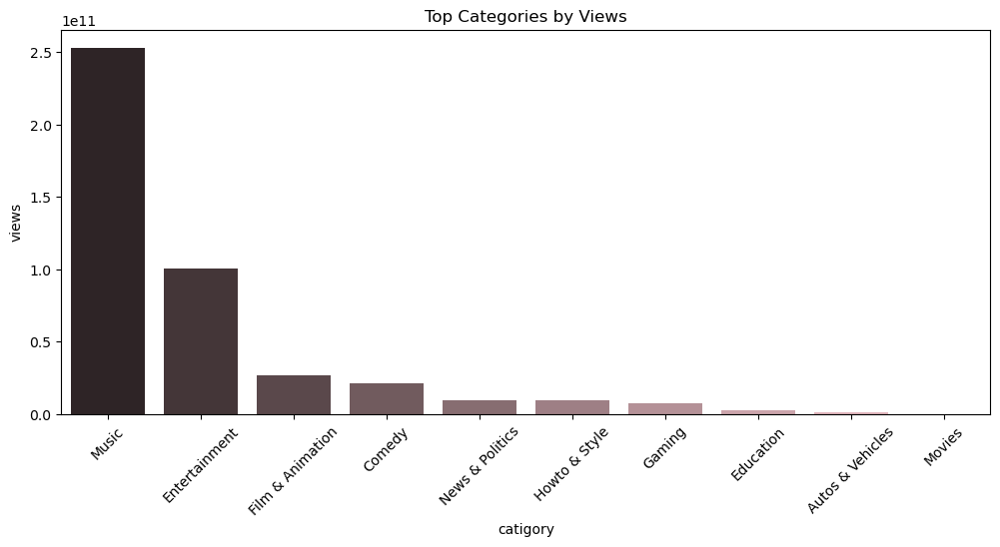

In [45]:
plt.figure(figsize=(12,5))
fig1 = sns.barplot(x=top10_categories_views.index,
                   y=top10_categories_views.values,
                   hue=top10_categories_views.index,
                   palette='dark:pink')
plt.title('Top Categories by Views')
plt.xlabel('catigory')
plt.ylabel('views')
plt.xticks(rotation=45)
plt.show

#### 📊 Top Performing Channels


In [46]:
# creating engagement column
df['engagement']= df['likes']+ df['comments']

In [47]:
# grouping total channels engagement 
top5_performing_channels = df.groupby(by='channel_title')['engagement'].sum().sort_values(ascending = False).head(5)
top5_performing_channels = top5_performing_channels.to_frame()

In [48]:
# check
top5_performing_channels.head(3)

,engagement
channel_title,
ibighit,850432724
Marvel Entertainment,338204169
ChildishGambinoVEVO,317111263


In [49]:
# visualize top channels 
fig2= px.pie(top5_performing_channels,names= top5_performing_channels.index,
       values=top5_performing_channels['engagement'],
       hole=0.6,title='Top 5 performing channels')
fig2.update_layout(title_x=0.5)
fig2.show()

#### 📊Top countries Activity / views

In [50]:
top5_countries_activity = df.groupby('country')['views'].mean().sort_values(ascending=False).head()
top5_countries_activity

country
GB    5.911293e+06
US    2.360678e+06
CA    1.147036e+06
IN    9.963425e+05
DE    6.034553e+05
Name: views, dtype: float64

In [51]:
# visualization
px.funnel(top5_countries_activity, x=top5_countries_activity.index,y=top5_countries_activity.values,
          title='Top5 countries activity',
          orientation='v')

#### 📊 What’s the best hour in the day to post videos?

In [52]:
# Creating data frame that contains time publish_time rounded to the nearest hour and views
# Adding arbitrary date to be able to round it
df10 = pd.DataFrame()
df10['publish_dt'] = pd.to_datetime('2006-01-07 ' + df['publish_time'].astype(str))
# Round to nearest hour
df10['rounded_publish_dt'] = df10['publish_dt'].dt.round('h')
# Extract just the time
df10['rounded_publish_time'] = df10['rounded_publish_dt'].dt.time
# adding views column
df10['views'] = df['views']
# check
df10.sample(5)

,publish_dt,rounded_publish_dt,rounded_publish_time,views
42766,2006-01-07 11:43:08,2006-01-07 12:00:00,12:00:00,16064
63946,2006-01-07 16:30:01,2006-01-07 17:00:00,17:00:00,31405
352336,2006-01-07 12:00:01,2006-01-07 12:00:00,12:00:00,361655
230362,2006-01-07 04:45:04,2006-01-07 05:00:00,05:00:00,231645
319187,2006-01-07 18:41:42,2006-01-07 19:00:00,19:00:00,21402


In [53]:
# grouping avg. views for each hour
df11 = df10.groupby('rounded_publish_time')['views'].mean()
df11 = pd.DataFrame(df11)
df11.head(2)

,views
rounded_publish_time,
00:00:00,1.636652e+06
01:00:00,1.255295e+06


In [54]:
# move index to a regular column
df11 = df11.reset_index() 

<function matplotlib.pyplot.show(close=None, block=None)>

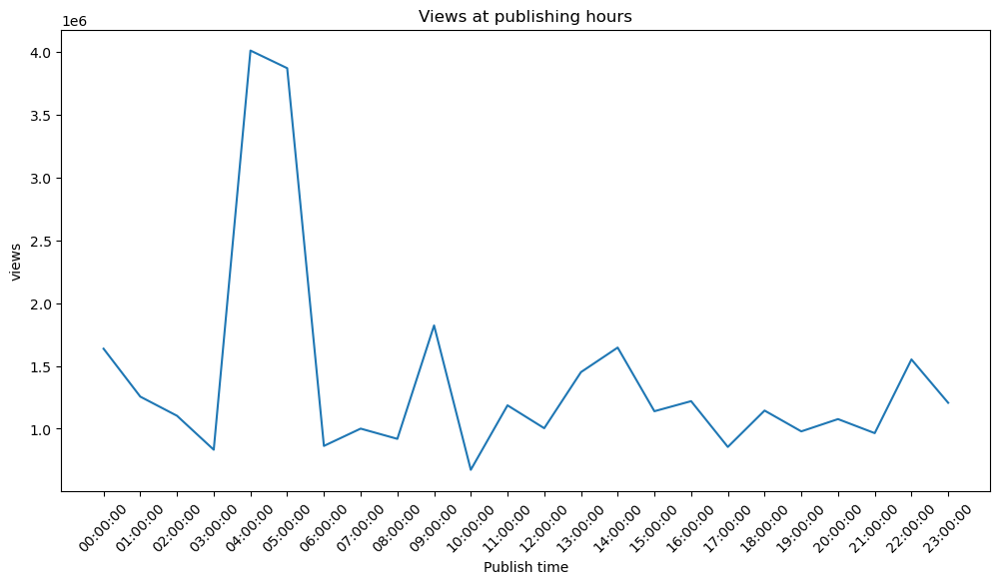

In [55]:
plt.figure(figsize=(12,6))
sns.lineplot(data=df11, x=df11['rounded_publish_time'].astype(str), y='views')
plt.title('Views at publishing hours')
plt.xticks(rotation=45)
plt.xlabel('Publish time')
plt.show

In [56]:
df.columns

Index(['trending_date', 'title', 'channel_title', 'publish_time', 'views',
       'likes', 'dislikes', 'comments', 'comments_disabled',
       'ratings_disabled', 'video_error_or_removed', 'description', 'country',
       'category', 'engagement_rate', 'publish_day', 'days_to_trend',
       'engagement'],
      dtype='object')

#### 📊 correlation between publish_time and engagement

In [57]:
df10['engagement'] = df['engagement']
df12 = df10.groupby('rounded_publish_time')['engagement'].mean()
df12 = df12.reset_index()

In [58]:
fig5 = px.line(df12,x=df12['rounded_publish_time'], y=df12['engagement'],hover_name='rounded_publish_time',
               title='Total engagement at publishing hours',
               labels={'rounded_publish_time':'Publish time','engagement':'Engagement'})
fig5.update_layout(title_x=0.5)
fig5.show()

#### 📊 Do videos with disabled comments perform worse?

In [59]:
# Initial idea
df.groupby('comments_disabled')['views'].mean()

comments_disabled
False    1.350712e+06
True     1.004819e+06
Name: views, dtype: float64

In [60]:
# scatter for more clarification
fig6= px.scatter(df,x=df.index,y='views',color='comments_disabled',
           labels={'index':'Video index','views':'Views'},
           title='Comments on VS comments off')
fig6.update_layout(title_x=0.5)

## 📌 Conclusion & Recommendations
---

### 🔍 Key Insights:
- **Engagement Rate** was highest for videos published between **3 AM and 6 AM**, suggesting that early morning uploads may benefit from lower competition or align with peak viewing times in other regions.
- **Time to Trend** varied significantly by country, with some markets (e.g., the US) showing faster trending dynamics.
- **Top Performing Categories** included **Entertainment, Music, and Film&Animation**, which consistently attracted high views and interaction.
- **Top Channels** were those that posted consistently and maintained a strong audience base.
- **Countries with the Highest Views** were the **GB, US ,and CA**, indicating strong demand in these markets.
- **Disabled Comments** correlated with slightly lower engagement, likely due to reduced opportunities for audience interaction.

---

### 💡 Recommendations:
- **Optimal Posting Time**: Creators should consider publishing videos between **3 AM and 6 AM** to capitalize on higher engagement rates observed in this timeframe.
- **Enable Comments**: To maintain higher engagement, avoid disabling comments unless necessary.
- **Focus on High-Engagement Categories**: Emphasize creating content in top categories such as **Music**, **Entertainment**, and **Film&Animation**.
- **Be Consistent**: Channels that trend often are those that publish frequently and maintain viewer trust.
- **Leverage Regional Trends**: Tailor content and timing to top-viewing countries to maximize reach and relevance.
---

📈 These findings can help content creators and digital marketers optimize their YouTube strategy for visibility, engagement, and audience growth.